In [25]:
from box import Box
from utils.util import read_yaml
import pandas as pd
from matplotlib import pyplot as plt
import missingno as msno

import numpy as np
import plotly.figure_factory as ff
import seaborn as sns
import plotly.graph_objects as go

import plotly.io as pio
# pio.renderers.default = 'notebook'

### Data Loading

In [26]:
cfg = Box(read_yaml('../src/conf/config.yaml'))

In [27]:
df = pd.read_csv(cfg.path.raw_data, parse_dates=['Date'], index_col=['Date'])
df.head()

,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FI696 Augusta,OXO-5FIC132 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,OXO-5FIC606A Augusta,OXO-5FIC606C Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
Date,,,,,,,,,,,,,,,,,,,,,
2019-11-01 00:00:00,5859.125648,23345.857389,9830.200195,4.450549,2076.174093,67.208298,5069.174366,0.0,NaN,1.202029,...,133.996300,130.578919,133.007764,134.032267,130.899539,298.029910,21719.630615,22870.976318,22026.824772,22036.315560
2019-11-01 01:00:00,5950.173837,23346.553467,9384.632992,4.410112,2070.199284,67.204392,5068.014148,0.0,NaN,1.158160,...,133.994588,130.640505,132.966600,134.035076,130.849780,298.084330,21727.622575,22879.205452,22042.948193,22056.644971
2019-11-01 02:00:00,6379.102250,23430.336545,9233.277262,4.285714,2067.933828,67.031974,5069.603650,0.0,NaN,1.070420,...,134.008106,130.675602,133.035094,134.001994,130.743083,297.930878,21836.766659,22970.057215,22156.774258,22105.218684
2019-11-01 03:00:00,6337.343084,23384.694743,9223.139014,4.775281,2062.488529,66.808810,5061.608939,0.0,NaN,1.044098,...,134.008312,130.613462,133.000552,133.979115,130.760757,298.052583,21783.450505,22920.952018,22088.356950,22064.178402
2019-11-01 04:00:00,6183.590302,23357.085677,9104.168620,4.388889,2055.162223,66.354369,5004.132636,0.0,NaN,1.044098,...,134.002098,130.614549,133.004748,134.000492,130.814450,298.039928,21748.715137,22895.312126,22073.622298,22053.480892


In [28]:
df.columns

Index(['OXO-5FI635C Augusta', 'OXO-5FI661A Augusta', 'OXO-5FI696 Augusta',
       'OXO-5FIC132 Augusta', 'OXO-5FIC600 Augusta', 'OXO-5FIC601 Augusta',
       'OXO-5FIC602 Augusta', 'OXO-5FIC603 Augusta', 'OXO-5FIC606A Augusta',
       'OXO-5FIC606C Augusta', 'OXO-5FIC607 Augusta', 'OXO-5FIC609A Augusta',
       'OXO-5FIC609B Augusta', 'OXO-5FIC611A Augusta', 'OXO-5FIC611B Augusta',
       'OXO-5FIC612A Augusta', 'OXO-5FIC612B Augusta', 'OXO-5FIC618A Augusta',
       'OXO-5FIC618B Augusta', 'OXO-5FIC618C Augusta', 'OXO-5FIC618D Augusta',
       'OXO-5FIC622A Augusta', 'OXO-5FIC622B Augusta', 'OXO-5FIC622C Augusta',
       'OXO-5FIC636A Augusta', 'OXO-5FIC636B Augusta', 'OXO-5FIC636C Augusta',
       'OXO-5FQI691B Augusta', 'OXO-5LI633B Augusta', 'OXO-5LI650F Augusta',
       'OXO-5LI651E Augusta', 'OXO-5LI651F Augusta', 'OXO-5LI652E Augusta',
       'OXO-5LI652F Augusta', 'OXO-5LI653E Augusta', 'OXO-5LI653F Augusta',
       'OXO-5LI654E Augusta', 'OXO-5LI654F Augusta', 'OXO-5LI655F Augu

In [29]:
columns = df.columns
target_list = []
for col in columns:
    for tag in ["5FI696", "5FIC612A", "5FIC612B", "5FIC600", "5FIC601"]:
        if tag in col:
            target_list.append(col)
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

In [30]:
# move target_list to the front
df = df[target_list + [col for col in df.columns if col not in target_list]]

In [31]:
df.shape

(28821, 59)

In [32]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 28821 entries, 2019-11-01 00:00:00 to 2023-04-05 21:00:00
Data columns (total 59 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   OXO-5FI696 Augusta     28124 non-null  float64
 1   OXO-5FIC600 Augusta    28149 non-null  float64
 2   OXO-5FIC601 Augusta    28147 non-null  float64
 3   OXO-5FIC612A Augusta   28148 non-null  float64
 4   OXO-5FIC612B Augusta   28219 non-null  float64
 5   OXO-5FI635C Augusta    28171 non-null  float64
 6   OXO-5FI661A Augusta    28124 non-null  float64
 7   OXO-5FIC132 Augusta    27956 non-null  float64
 8   OXO-5FIC602 Augusta    28148 non-null  float64
 9   OXO-5FIC603 Augusta    28147 non-null  float64
 10  OXO-5FIC606A Augusta   16413 non-null  float64
 11  OXO-5FIC606C Augusta   28149 non-null  float64
 12  OXO-5FIC607 Augusta    28123 non-null  float64
 13  OXO-5FIC609A Augusta   28123 non-null  float64
 14  OXO-5FIC609B August

In [33]:
# Create a dictionary to map the category to each tag
tag_df = pd.read_excel(cfg.path.tags_info)
# delete the first 3 str characters in the tag name
tag_df['Tag'] = tag_df['Tag'].apply(lambda x: x[3:])
# convert the . into - in the tag name
tag_df['Tag'] = tag_df['Tag'].apply(lambda x: x.replace('.', '-'))

tag_dict = dict(zip(tag_df['Tag'], tag_df['Category']))
print(tag_dict)

{'OXO-5FI635C Augusta': 'Measurement', 'OXO-5FI661A Augusta': 'Measurement', 'OXO-5FI696 Augusta': 'Independent', 'OXO-5FIC132 Augusta': 'Independent', 'OXO-5FIC600 Augusta': 'Target', 'OXO-5FIC601 Augusta': 'Target', 'OXO-5FIC602 Augusta': 'Control', 'OXO-5FIC603 Augusta': 'Control', 'OXO-5FIC606A Augusta': 'Control', 'OXO-5FIC606C Augusta': 'Control', 'OXO-5FIC607 Augusta': 'Control', 'OXO-5FIC609A Augusta': 'Target', 'OXO-5FIC609B Augusta': 'Control', 'OXO-5FIC611A Augusta': 'Control', 'OXO-5FIC611B Augusta': 'Control', 'OXO-5FIC612A Augusta': 'Target', 'OXO-5FIC612B Augusta': 'Target', 'OXO-5FIC618A Augusta': 'Control', 'OXO-5FIC618B Augusta': 'Control', 'OXO-5FIC618C Augusta': 'Control', 'OXO-5FIC618D Augusta': 'Control', 'OXO-5FIC622A Augusta': 'Control', 'OXO-5FIC622B Augusta': 'Control', 'OXO-5FIC622C Augusta': 'Control', 'OXO-5FIC636A Augusta': 'Control', 'OXO-5FIC636B Augusta': 'Control', 'OXO-5FIC636C Augusta': 'Control', 'OXO-5FQI691B Augusta': 'Measurement', 'OXO-5LI633B A

### Missing Values Processing<a name="clean"></a>

In [34]:
df.isnull().sum()

OXO-5FI696 Augusta         697
OXO-5FIC600 Augusta        672
OXO-5FIC601 Augusta        674
OXO-5FIC612A Augusta       673
OXO-5FIC612B Augusta       602
OXO-5FI635C Augusta        650
OXO-5FI661A Augusta        697
OXO-5FIC132 Augusta        865
OXO-5FIC602 Augusta        673
OXO-5FIC603 Augusta        674
OXO-5FIC606A Augusta     12408
OXO-5FIC606C Augusta       672
OXO-5FIC607 Augusta        698
OXO-5FIC609A Augusta       698
OXO-5FIC609B Augusta       673
OXO-5FIC611A Augusta       938
OXO-5FIC611B Augusta     12503
OXO-5FIC618A Augusta       577
OXO-5FIC618B Augusta       673
OXO-5FIC618C Augusta       914
OXO-5FIC618D Augusta       697
OXO-5FIC622A Augusta       698
OXO-5FIC622B Augusta       698
OXO-5FIC622C Augusta       673
OXO-5FIC636A Augusta       673
OXO-5FIC636B Augusta       650
OXO-5FIC636C Augusta       626
OXO-5FQI691B Augusta       650
OXO-5LI633B Augusta        625
OXO-5LI650F Augusta        697
OXO-5LI651E Augusta        649
OXO-5LI651F Augusta        697
OXO-5LI6

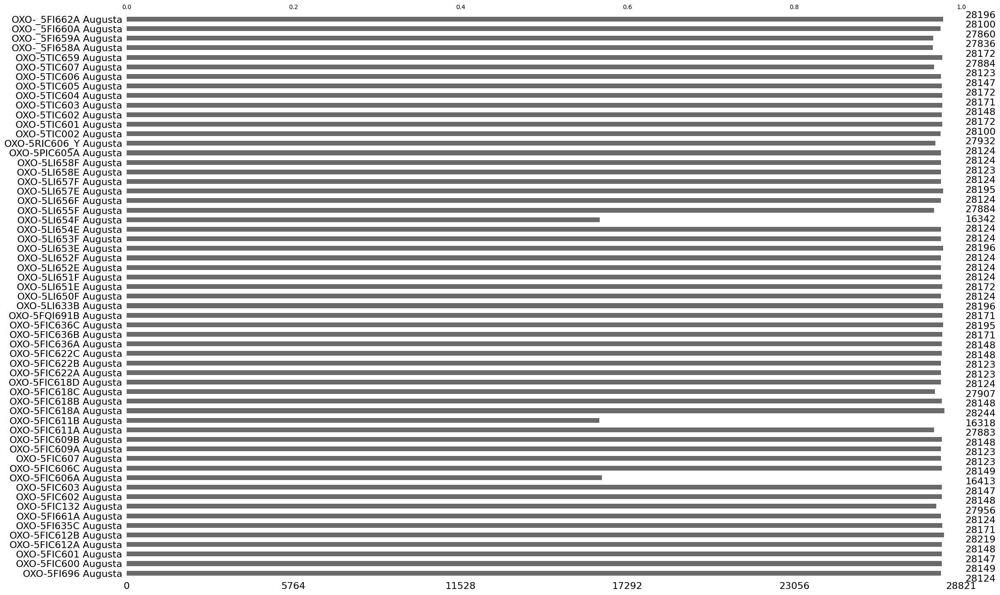

In [35]:
# Displaying a bar chart for the non-missing values of each column
msno.bar(df)
plt.show()

In [36]:
# drop rows with missing values in the target_list
df = df.dropna(subset=target_list)
df.shape

(28123, 59)

In [37]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.4]

OXO-5FIC606A Augusta    11806
OXO-5FIC611B Augusta    11806
OXO-5LI654F Augusta     11806
dtype: int64

In [38]:
del_cols = [i for i in df.columns if df[i].isnull().sum() / df.shape[0] > 0.4]
print(del_cols)

['OXO-5FIC606A Augusta', 'OXO-5FIC611B Augusta', 'OXO-5LI654F Augusta']


In [39]:
# drop columns with more than 40% missing values
for col in del_cols:
    if col not in target_list and tag_dict[col] != 'Control':
        df.drop(columns=col, inplace=True)

In [40]:
# Check if there are deleted successful
df.shape

(28123, 58)

In [41]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.1]

OXO-5FIC606A Augusta    11806
OXO-5FIC611B Augusta    11806
dtype: int64

In [42]:
# Fill the rest with missing values
fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
print(fill_cols)
print(len(fill_cols))

['OXO-5FI635C Augusta', 'OXO-5FI661A Augusta', 'OXO-5FIC132 Augusta', 'OXO-5FIC606A Augusta', 'OXO-5FIC611A Augusta', 'OXO-5FIC611B Augusta', 'OXO-5FIC618C Augusta', 'OXO-5LI633B Augusta', 'OXO-5LI655F Augusta', 'OXO-5RIC606_Y Augusta', 'OXO-5TIC002 Augusta', 'OXO-5TIC607 Augusta', 'OXO-_5FI658A Augusta', 'OXO-_5FI659A Augusta', 'OXO-_5FI660A Augusta', 'OXO-_5FI662A Augusta']
16


In [43]:
# # fill in the missing values with the mean of each column
# for j in fill_cols:
#     df[j]=df[j].fillna(df[j].mean())

# # Check if there is still a column that has missing values
# fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
# print(fill_cols)

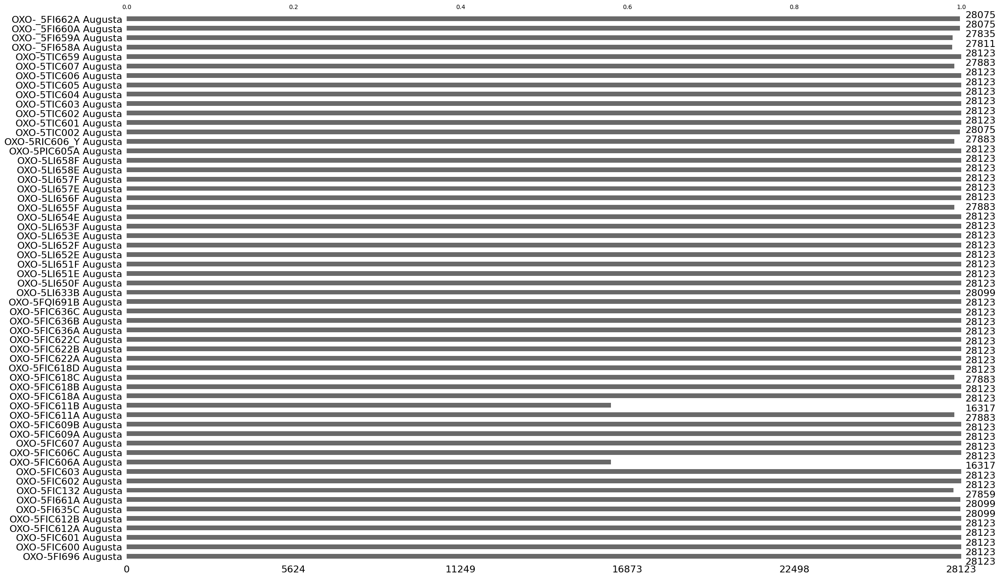

In [44]:
msno.bar(df)
plt.show()

### Outliers

In [45]:
del_cols_zero = [i for i in df.columns if (df[i]==0).sum() / len(df) > 0.5]
del_cols_zero

['OXO-5FIC607 Augusta', 'OXO-5FIC618A Augusta']

In [46]:
for col in del_cols_zero:
    if col not in target_list and tag_dict[col] != 'Control':
        df.drop(columns=col, inplace=True)
df.shape

(28123, 58)

### Correlation Analysis<a name="clean"></a>

In [47]:
df_corr = df.corr() # Generate correlation matrix

# By default, corr() calculates the Pearson correlation coefficient between each pair of columns.
# The Pearson correlation coefficient is a measure of the linear relationship between two variables. 
# It ranges from -1 to 1, where -1 indicates a perfect negative correlation, 0 indicates no correlation, and 1 indicates a perfect positive correlation.

fig = go.Figure()
fig.add_trace(go.Heatmap(x=df_corr.columns, y=df_corr.index, z=np.array(df_corr)))
fig.update_layout(
    width=1200,
    height=1200
)
# fig.write_html("./image/corr_heatmap.html")
fig.show()

Pairs of highly correlated features:
('OXO-5FIC612A Augusta', 'OXO-5FIC609A Augusta')
('OXO-5FIC612B Augusta', 'OXO-5FIC609B Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI660A Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI662A Augusta')
('OXO-5LI651E Augusta', 'OXO-5LI651F Augusta')
('OXO-5LI652E Augusta', 'OXO-5LI652F Augusta')
('OXO-5LI653E Augusta', 'OXO-5LI653F Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC603 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC606 Augusta', 'OXO-5TIC607 Augusta')
('OXO-_5FI659A Au

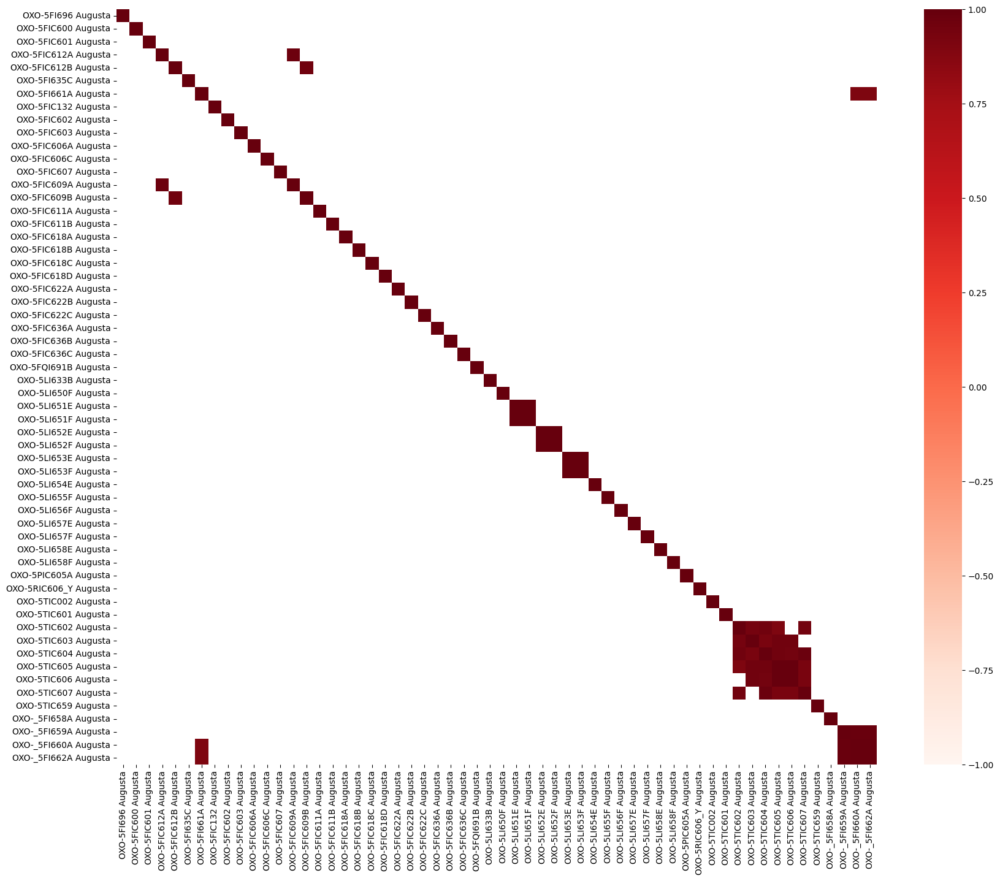

In [48]:
# Define a threshold for high correlation
threshold = 0.9

# Extract pairs of highly correlated features
high_corr_pairs = []
for i in range(len(df_corr.columns)):
    for j in range(i+1, len(df_corr.columns)):
        if abs(df_corr.iloc[i, j]) > threshold:
            high_corr_pairs.append((df_corr.columns[i], df_corr.columns[j]))

# Print the highly correlated feature pairs
print("Pairs of highly correlated features:")
for pair in high_corr_pairs:
    print(pair)

fig = plt.subplots(figsize=(20, 16))

sns.heatmap(df_corr[df_corr>0.9], vmax=1, vmin=-1, center=0, cmap = 'Reds')
# plt.savefig("./image/corr_matrix.png", dpi=300)
plt.show()

In [49]:
# # Drop highly correlated columns
# drop_cols = ['OXO-5FIC609A Augusta',
#                       'OXO-5FIC609B Augusta', 
#                       'OXO-5FI661A Augusta',
#                       'OXO-5LI651E Augusta',
#                       'OXO-5LI652E Augusta',
#                       'OXO-5LI653E Augusta',
#                       'OXO-5TIC602 Augusta',
#                       'OXO-5TIC603 Augusta',
#                       'OXO-5TIC604 Augusta',
#                       'OXO-5TIC605 Augusta',
#                       'OXO-5TIC606 Augusta',
#                       'OXO-5TIC607 Augusta',
#                       'OXO-_5FI659A Augusta',
#                       'OXO-_5FI660A Augusta',
#                       'OXO-_5FI662A Augusta']

# # If the Category lable of that tag is 'Control', we don't drop it
# for col in drop_cols:
#     col_origin = col.replace('OXO-', 'T2.OXO.')
#     if  tag_dict[col_origin] == 'Control':
#         drop_cols.remove(col)

# drop_cols

In [50]:
# df = df.drop(columns=drop_cols)
# df.head()

In [51]:
df.shape

(28123, 58)

In [52]:
# from BorutaShap import BorutaShap
# # from sklearn.datasets import load_boston

# X = df.drop(columns=['OXO-5FI696 Augusta'])
# # input_columns = df.loc[:, df.columns != "class"]
# y = df['OXO-5FI696 Augusta']

# Feature_Selector = BorutaShap(importance_measure='shap', classification=False)
# Feature_Selector.fit(X=X, y=y, n_trials=100, random_state=0)

# # Check selected features
# print(Feature_Selector.Subset())

### Target Variables Distribution<a name="clean"></a>

In [53]:
import plotly.express as px

fig = px.line(df, x=df.index, y=target_list)
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

Output: OXO-5FI696 Augusta

In [54]:
# Check the output, 'OXO-5FI696 Augusta', when it drop down to 0
# Focus on the last three variables

fig = px.line(df, x=df.index, y=target_list[0])
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 10])
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [55]:
# find indices where value goes below the threshold

threshold = 2000

zero_indices = df[df[cfg.kpi1.tag1] < threshold].index
print(zero_indices.shape)

# output timestamps
# for index in zero_indices:
#     print(df['Date'][index])

# delete rows
df = df.drop(zero_indices)

(2091,)


In [56]:
df.shape

(26032, 58)

In [57]:
# Check if rows are deleted successfully
df.loc[(df.index >= '2021-03-06') & (df.index < '2021-03-07')]

,OXO-5FI696 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC612A Augusta,OXO-5FIC612B Augusta,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FIC132 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
Date,,,,,,,,,,,,,,,,,,,,,


In [58]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

'OXO-5FIC601 Augusta', 'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [59]:
# Focus on the last three variables

fig = px.line(df, x=df.index, y=target_list[2:])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [60]:
# Focus on the last two variables

fig = px.line(df, x=df.index, y=target_list[3:])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [61]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

KPI1 Variation

In [62]:
# Let's check KPI1
kpi = df[target_list[0]] / ((df[target_list[3]] + df[target_list[4]])*1000 + df[target_list[1]] + df[target_list[2]])
df['kpi1'] = kpi

fig = px.line(df, x=df.index, y=kpi)
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [63]:
# View the value between 0 and 1.5, mark the data points out of [0.84, 0.9] as red

fig = px.line(df, x=df.index, y=kpi)
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 1.5])
)
fig.add_shape(
        # Line Horizontal
        type="line",
        x0=df.index[0],
        y0=0.84,
        x1=df.index[-1],
        y1=0.84,
        line=dict(
            color="Red",
            width=2,
            dash="dashdot",
        ),
    )
fig.add_shape(
        # Line Horizontal
        type="line",
        x0=df.index[0],
        y0=0.9,
        x1=df.index[-1],
        y1=0.9,
        line=dict(
            color="Red",
            width=2,
            dash="dashdot",
        ),
    )
# fig.add_trace(go.Scatter(
#     x=df.index,
#     y=kpi,
#     mode="markers",
#     marker=dict(
#         color='rgba(255, 0, 0, 0.5)',
#         size=5,
#         line=dict(
#             color='DarkSlateGrey',
#             width=2
#         )
#     )
# ))

# fig.write_html("./image/target_variables.html")
fig.show()

### Variance Analysis<a name="clean"></a>

In [64]:
std = df.std()
std.shape

(59,)

In [65]:
std

OXO-5FI696 Augusta         2033.348075
OXO-5FIC600 Augusta         341.776556
OXO-5FIC601 Augusta          19.215577
OXO-5FIC612A Augusta          3.625967
OXO-5FIC612B Augusta          3.242087
OXO-5FI635C Augusta        2211.450356
OXO-5FI661A Augusta        8498.312469
OXO-5FIC132 Augusta        3241.966264
OXO-5FIC602 Augusta        2635.499807
OXO-5FIC603 Augusta        2789.754798
OXO-5FIC606A Augusta        570.653474
OXO-5FIC606C Augusta        675.950039
OXO-5FIC607 Augusta         803.817485
OXO-5FIC609A Augusta       1033.048558
OXO-5FIC609B Augusta        920.413096
OXO-5FIC611A Augusta       3323.050954
OXO-5FIC611B Augusta       3498.044952
OXO-5FIC618A Augusta       1848.159354
OXO-5FIC618B Augusta       1343.547510
OXO-5FIC618C Augusta       1229.581713
OXO-5FIC618D Augusta       1101.514992
OXO-5FIC622A Augusta        987.688188
OXO-5FIC622B Augusta        766.895742
OXO-5FIC622C Augusta        854.008795
OXO-5FIC636A Augusta       3243.723161
OXO-5FIC636B Augusta     

In [66]:
fig = go.Figure(data=[go.Bar(x=df.columns, y=std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [67]:
# Take a look at that weird tag
fig = px.line(df, x=df.index, y='OXO-5FQI691B Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [68]:
# It's because the magnitude of the values in that column are large
# Let's try normalized std

norm_std = df.std(ddof=0) / df.mean()
norm_std

OXO-5FI696 Augusta        0.200939
OXO-5FIC600 Augusta       0.163088
OXO-5FIC601 Augusta       0.257877
OXO-5FIC612A Augusta      1.185159
OXO-5FIC612B Augusta      0.492688
OXO-5FI635C Augusta       0.365089
OXO-5FI661A Augusta       0.276336
OXO-5FIC132 Augusta       0.996622
OXO-5FIC602 Augusta       0.646853
OXO-5FIC603 Augusta       0.769007
OXO-5FIC606A Augusta      0.858979
OXO-5FIC606C Augusta      0.876633
OXO-5FIC607 Augusta       1.182743
OXO-5FIC609A Augusta      1.189035
OXO-5FIC609B Augusta      0.497240
OXO-5FIC611A Augusta      1.459811
OXO-5FIC611B Augusta      0.553866
OXO-5FIC618A Augusta      1.049822
OXO-5FIC618B Augusta      0.432151
OXO-5FIC618C Augusta      0.300534
OXO-5FIC618D Augusta      0.360036
OXO-5FIC622A Augusta      1.159086
OXO-5FIC622B Augusta      0.353264
OXO-5FIC622C Augusta      0.374469
OXO-5FIC636A Augusta      0.851385
OXO-5FIC636B Augusta      0.928446
OXO-5FIC636C Augusta      0.698769
OXO-5FQI691B Augusta      0.529788
OXO-5LI633B Augusta 

In [69]:
fig = go.Figure(data=[go.Bar(x=df.columns, y=norm_std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [70]:
# Take a look at that weird tag

fig = px.line(df, x=df.index, y='OXO-5RIC606_Y Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [71]:
# That column has lots of spikes, and also remain in 0 for a long time, so we decided to drop it.
if tag_dict['OXO-5RIC606_Y Augusta'] != 'Control':
    df = df.drop(columns=['OXO-5RIC606_Y Augusta'])
df.shape

(26032, 59)

In [72]:
df.to_csv(cfg.path.processed_data)

In [73]:
# Check for extremely small variance

small_std = [x for x in norm_std if x < 0.1]
small_std

[0.0725532695919991,
 0.07028099173088422,
 0.042112434311244694,
 0.05010181529967062,
 0.05096975239079607,
 0.0444715073510278]